In [1]:
using Flux
using HDF5
using Random
using Flux: flatten
using Flux.Data: DataLoader
using ProgressBars
using Flux: update!
using Plots
using LinearAlgebra
default(fontfamily="Computer Modern", framestyle=:box)

In [2]:
using Images

In [3]:
using BSON
using DataFrames
using CSV

In [4]:
include("lines_to_crosstrack.jl")

get_state (generic function with 1 method)

# Load in the Trajectory Data

In [5]:
data_dir = "/scratch/smkatz/class/CS231A/E16Data_traj/"
gt_labels = CSV.read("$(data_dir)labels.csv", DataFrame)

,filename,crosstrack,heading,downtrack,leftx1,lefty1,leftx2,lefty2,rightx1
,String7,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0.png,0.0,28.6479,250.0,1615.84,560.647,1700.95,577.298,1559.11
2,1.png,0.239713,28.6479,250.439,1616.48,560.65,1703.68,577.372,1559.67
3,2.png,0.479151,28.6121,250.878,1616.15,560.648,1705.38,577.438,1559.32
4,3.png,0.717767,28.5048,251.317,1613.94,560.629,1705.1,577.468,1557.16
5,4.png,0.955013,28.3262,251.757,1609.84,560.594,1702.73,577.459,1553.18
6,5.png,1.19034,28.0768,252.198,1603.88,560.543,1698.38,577.417,1547.42
7,6.png,1.4232,27.7573,252.641,1596.1,560.483,1692.01,577.36,1539.91
8,7.png,1.65306,27.3684,253.085,1586.56,560.414,1683.74,577.292,1530.71
9,8.png,1.87936,26.911,253.531,1575.3,560.337,1673.56,577.21,1519.85


In [19]:
# Load in the data
data_fn = "$(data_dir)downsampled_64.h5"
imgs = Float32.(h5read(data_fn, "X_train"))
X = reshape(imgs, size(imgs, 1), size(imgs, 2), 1, size(imgs, 3))
labels = Float32.(h5read(data_fn, "y_train"));

# Image Plotting Functions

In [7]:
gt_labels[1, 5]

1615.843509

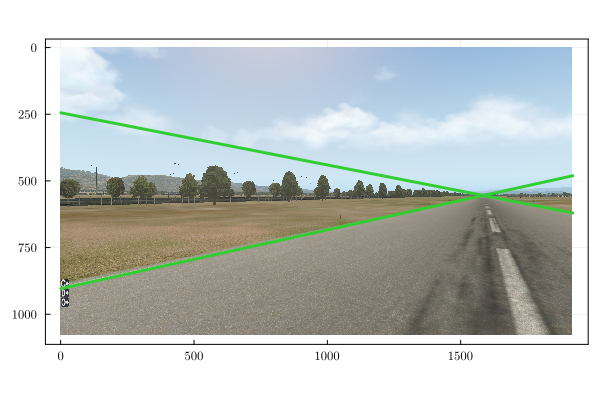

In [8]:
function get_line(p1, p2)
    l = cross(p1, p2)
    return -l[1] / l[2], -l[3] / l[2]
end

function get_pixels(m, b, w, h)
    xs = collect(1:w)
    ys = [m * x + b for x in xs]
    keep_inds = (ys .> 0) .& (ys .< h)
    return xs[keep_inds], ys[keep_inds]
end

function plot_image(ind; kwargs...)
    filename = "$(data_dir)$(ind).png"
    img = load(filename)

    h, w = size(img)
    m1, b1 = get_line([gt_labels[ind+1, 5], gt_labels[ind+1, 6], 1], [gt_labels[ind+1, 7], gt_labels[ind+1, 8], 1])
    xs1, ys1 = get_pixels(m1, b1, w, h)
    m2, b2 = get_line([gt_labels[ind+1, 9], gt_labels[ind+1, 10], 1], [gt_labels[ind+1, 11], gt_labels[ind+1, 12], 1])
    xs2, ys2 = get_pixels(m2, b2, w, h)

    p = plot(img; kwargs...)
    plot!(p, xs1, ys1, color=:limegreen, lw=3, legend=false)
    plot!(p, xs2, ys2, color=:limegreen, lw=3, legend=false)
    return p
end

plot_image(0)

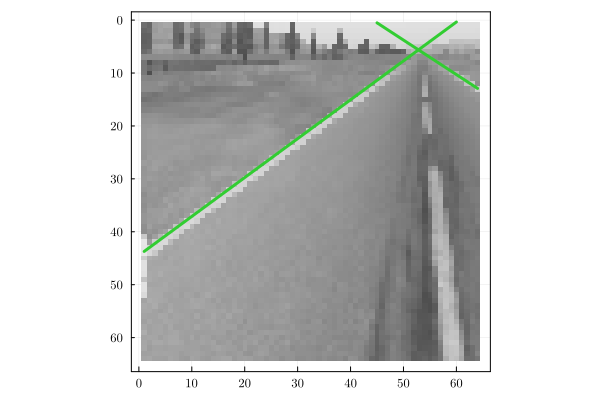

In [75]:
function plot_image_ds(ind; kwargs...)
    img = imgs[:, :, 1, ind]

    h, w = size(img)
    m1, b1 = labels[1, ind], labels[2, ind]
    xs1, ys1 = get_pixels(m1, b1, w, h)
    m2, b2 = labels[3, ind], labels[4, ind]
    xs2, ys2 = get_pixels(m2, b2, w, h)

    p = heatmap(Gray.(img'); kwargs...)
    plot!(p, xs1, ys1, color=:limegreen, lw=3, legend=false)
    plot!(p, xs2, ys2, color=:limegreen, lw=3, legend=false)
    return p
end

p = plot_image_ds(1)

# Load in the Model

In [15]:
model = BSON.load("../../initial_model.bson")[:model];

# Get Predictions and Plot

In [20]:
preds = model(X);

In [22]:
n = size(X, 4)

crosstrack_preds_r = zeros(n)
heading_preds_r = zeros(n)

crosstrack_preds_l = zeros(n)
heading_preds_l = zeros(n)

zs = ones(n)

for i = 1:n
    cr, hr = get_state(preds[1, i], preds[2, i], K0, ground_plane_sm, u1_sm, c1_sm, hw_sm, right=true)
    cl, hl = get_state(preds[3, i], preds[4, i], K0, ground_plane_sm, u1_sm, c1_sm, hw_sm, right=false)
    crosstrack_preds_r[i] = cr
    heading_preds_r[i] = hr
    crosstrack_preds_l[i] = cl
    heading_preds_l[i] = hl

    if abs(cr - cl) > 2 || (hr - hl) > 4
        zs[i] = 0
    end
end

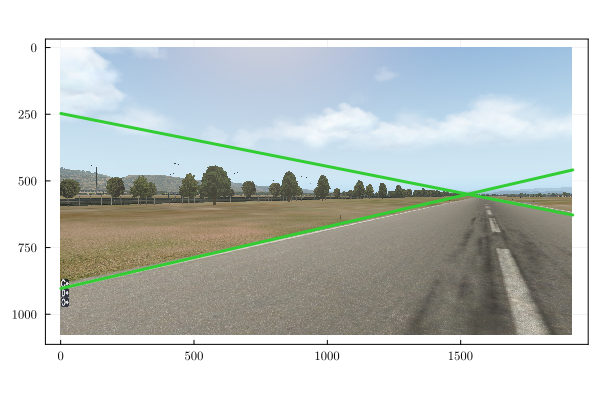

In [127]:
function plot_image_pred(ind; kwargs...)
    filename = "$(data_dir)$(ind).png"
    img = load(filename)

    h, w = size(img)
    l1 = undo_downsampling(preds[1, ind+1], preds[2, ind+1])
    l2 = undo_downsampling(preds[3, ind+1], preds[4, ind+1])
    m1, b1 = -l1[1] / l1[2], -l1[3] / l1[2]
    m2, b2 = -l2[1] / l2[2], -l2[3] / l2[2]
    xs1, ys1 = get_pixels(m1, b1, w, h)
    xs2, ys2 = get_pixels(m2, b2, w, h)

    p = plot(img; kwargs...)
    plot!(p, xs1, ys1, color=:limegreen, lw=3, legend=false)
    plot!(p, xs2, ys2, color=:limegreen, lw=3, legend=false)
    return p
end

plot_image_pred(0)

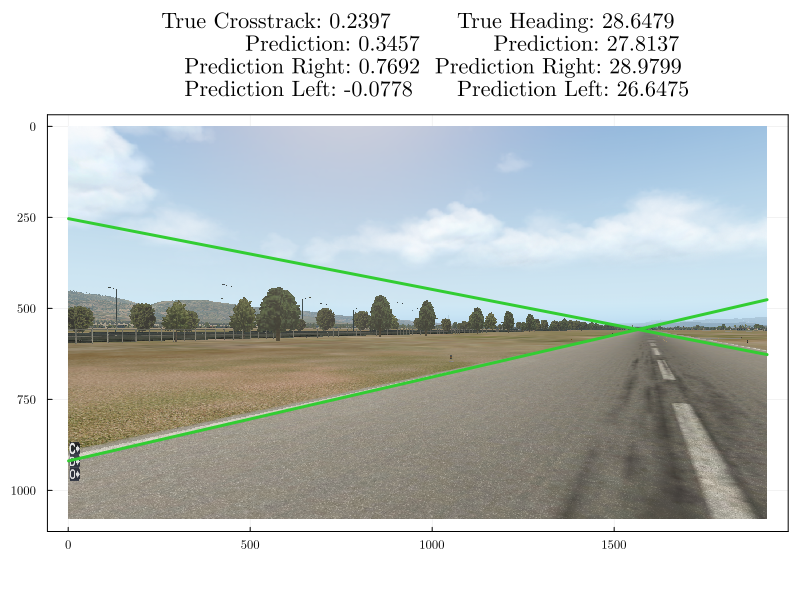

In [128]:
function plot_predictions(ind)
    title_string = "True Crosstrack: $(round(labels[5, ind], digits=4))         True Heading: $(round(labels[6, ind], digits=4))\n            Prediction: $(round((crosstrack_preds_r[ind] + crosstrack_preds_l[ind]) / 2, digits=4))          Prediction: $(round((heading_preds_r[ind] + heading_preds_l[ind]) / 2, digits=4))\n    Prediction Right: $(round(crosstrack_preds_r[ind], digits=4))  Prediction Right: $(round(heading_preds_r[ind], digits=4))\n     Prediction Left: $(round(crosstrack_preds_l[ind], digits=4))      Prediction Left: $(round(heading_preds_l[ind], digits=4))"
    # p1 = plot(title=title_string, grid = false, showaxis = false, bottom_margin = 10Plots.px, axis=nothing, titlefonthalign=:left)
    p2 = plot_image_pred(ind-1, title=title_string, bottom_margin=10Plots.px, size=(800, 600))
    # p3 = plot_image(ind-1, size=(400, 200))
    # return plot(p3, p2, size=(700, 500))
    return p2
end

p2 = plot_predictions(2)

In [130]:
# anim = @animate for i in 2:length(crosstrack_preds_l)
#     println(i)
#     plot_predictions(i)
# end
# Plots.gif(anim, "nominal.gif", fps=10)

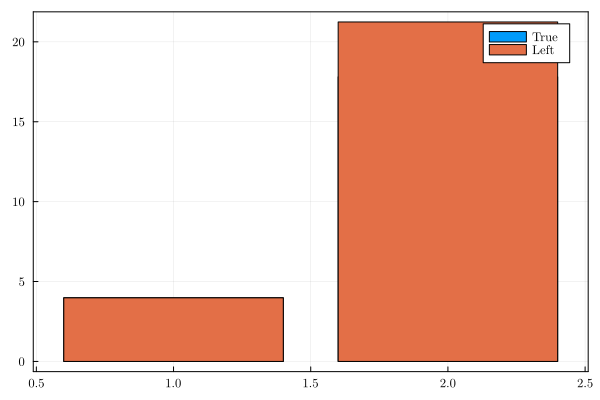

In [118]:
function bar_preds(ind)
    p = bar([labels[5, ind], labels[6, ind]], label="True")
    bar!(p, [crosstrack_preds_l[ind], heading_preds_l[ind]], label="Left")
    return p
end

bar_preds(2)